In [2]:
import os, glob, h5py, numpy as np, matplotlib.pyplot as plt
from IPython.display import HTML, display
from matplotlib.animation import FuncAnimation
from scipy.io import loadmat
import scipy.sparse as sp
from matplotlib.path import Path
from matplotlib.collections import PathCollection
from skimage.measure import find_contours

from suns import config as suns_config
from suns.Network.shallow_unet import get_shallow_unet
from suns.PostProcessing.complete_post import complete_segment

# Config
active_set = 'only_mouse7'
exp_id = 'mouse7_787'
list_Exp_ID = suns_config.EXP_ID_SETS[active_set]
dir_video = suns_config.DATAFOLDER_SETS[active_set]
dir_parent = os.path.join(dir_video, suns_config.OUTPUT_FOLDER[active_set])
dir_net_in = os.path.join(dir_parent, 'network_input')
weights_path = os.path.join(dir_parent, 'Weights')
dir_output = os.path.join(dir_parent, 'output_masks')

# Load preprocessed video
with h5py.File(os.path.join(dir_net_in, f"{exp_id}.h5"), "r") as f:
    network_input = np.array(f["network_input"])  # (T,Lx,Ly)
T, Lx, Ly = network_input.shape
vmin, vmax = np.percentile(network_input, [1, 99])

# Load optimized params
CV = len(list_Exp_ID)
opt_file = os.path.join(dir_output, f"Optimization_Info_{CV}.mat")
opt = loadmat(opt_file, squeeze_me=False, struct_as_record=False)

def _scalarize(v):
    if isinstance(v, np.ndarray):
        v = v.squeeze()
        if v.shape == ():
            v = v.item()
    return v

def load_params_dict(opt):
    P = opt['Params']
    if isinstance(P, np.ndarray):
        if getattr(P.dtype, 'names', None):
            P = {name: P[name][0,0] for name in P.dtype.names}
        else:
            if P.size == 1:
                P = P.ravel()[0]
            if isinstance(P, np.ndarray) and getattr(P.dtype, 'names', None):
                P = {name: P[name][0,0] for name in P.dtype.names}
            elif hasattr(P, '_fieldnames'):
                P = {name: getattr(P, name) for name in P._fieldnames}
            elif isinstance(P, dict):
                pass
            else:
                raise TypeError(f'Unsupported Params type after unwrap: {type(P)}')
    elif hasattr(P, '_fieldnames'):
        P = {name: getattr(P, name) for name in P._fieldnames}
    elif not isinstance(P, dict):
        raise TypeError(f'Unsupported Params type: {type(P)}')
    return {k: _scalarize(v) for k, v in P.items()}

Params = load_params_dict(opt)
minArea = float(np.array(Params['minArea']).reshape(()))
avgArea = float(np.array(Params['avgArea']).reshape(()))
thresh_pmap = int(np.array(Params['thresh_pmap']).reshape(()))
thresh_mask = float(np.array(Params['thresh_mask']).reshape(()))
thresh_COM0 = float(np.array(Params['thresh_COM0']).reshape(()))
thresh_COM  = float(np.array(Params['thresh_COM']).reshape(()))
thresh_IOU  = float(np.array(Params['thresh_IOU']).reshape(()))
thresh_consume = float(np.array(Params['thresh_consume']).reshape(()))
cons = int(np.array(Params['cons']).reshape(()))
Params_post = {
    'minArea': minArea, 'avgArea': avgArea, 'thresh_pmap': None,
    'thresh_mask': thresh_mask, 'thresh_COM0': thresh_COM0, 'thresh_COM': thresh_COM,
    'thresh_IOU': thresh_IOU, 'thresh_consume': thresh_consume, 'cons': cons
}

# Predicted masks (static across time; contours visible for all frames)
model = get_shallow_unet(size=None, Params_loss=None)
model.load_weights(os.path.join(weights_path, f"Model_CV{CV}.h5"))
prob_map = model.predict(network_input[..., None], batch_size=128).squeeze()[:, :Lx, :Ly]  # (T,Lx,Ly)
pmaps_b = (prob_map * 255.0).astype(np.uint8)
pmaps_b = (pmaps_b >= thresh_pmap).astype(np.uint8)
Masks_2, times_active = complete_segment(pmaps_b, Params_post, useMP=False, useWT=False, display=False)
pred_masks = np.reshape(Masks_2.toarray(), (Masks_2.shape[0], Lx, Ly)).astype(bool)
print(f"Predicted masks: {pred_masks.shape[0]}")

# GT masks (ROI shapes; contours visible for all frames)
gt_root = os.path.join(dir_video, 'GT Masks')
sparse_path = os.path.join(gt_root, f'FinalMasks_{exp_id}_sparse.mat')
dense_path = os.path.join(gt_root, f'FinalMasks_{exp_id}.mat')

def load_gt_rois(Lx, Ly):
    # Prefer sparse GT if available
    if os.path.isfile(sparse_path):
        md = loadmat(sparse_path)
        if 'GTMasks_2' in md:
            GT = md['GTMasks_2']
        elif 'GTMasks' in md:
            GT = md['GTMasks']
        else:
            raise KeyError(f'No GTMasks_2 or GTMasks in {sparse_path}')

        GT = sp.csc_matrix(GT)
        pixels = Lx * Ly
        if GT.shape[0] == pixels:
            GTp = GT
        elif GT.shape[1] == pixels:
            GTp = GT.transpose()
        else:
            raise ValueError(f'Unexpected sparse GT shape {GT.shape}, pixels={pixels}')
        n = GTp.shape[1]
        flat = (GTp > 0).astype(bool).toarray().T  # (n, pixels) in MATLAB column-major order
        rois = flat.reshape(n, Ly, Lx, order='F')  # (n, H=Ly, W=Lx)
        return rois.astype(bool)

    # Dense GT
    if os.path.isfile(dense_path):
        try:
            with h5py.File(dense_path, 'r') as f:
                arr = np.array(f['FinalMasks'])  # (Ly, Lx, n)
        except OSError:
            md = loadmat(dense_path)
            arr = np.array(md['FinalMasks'])    # (Ly, Lx, n)
        if arr.ndim == 3:
            # make (n, H=Ly, W=Lx)
            rois = np.transpose(arr, (2, 0, 1)).astype(bool)
        else:
            rois = arr.astype(bool)
        return rois

    raise FileNotFoundError(f'No GT file for {exp_id} in {gt_root}')

gt_rois = load_gt_rois(Lx, Ly)
print(f"GT masks: {gt_rois.shape[0]}")


importing config


2025-10-15 11:20:33.025935: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-10-15 11:21:08.148066: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1635] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 14784 MB memory:  -> device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:61:00.0, compute capability: 7.0
2025-10-15 11:21:11.682141: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:424] Loaded cuDNN version 8907
2025-10-15 11:21:12.413901: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-10-15 11:21:12.416524: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
20

13/13 [==============================] - 6s 63ms/step
Predicted masks: 980
GT masks: 1104


In [3]:
from skimage.measure import find_contours, approximate_polygon
from matplotlib.path import Path
from matplotlib.collections import PathCollection

def crop_to_mask(frames, masks):  # frames: (T,H,W), masks: (N,Hm,Wm)
    Hm, Wm = masks.shape[1], masks.shape[2]
    return frames[:, :Hm, :Wm]

def masks_to_paths_aligned(
    masks, *,
    origin='lower',
    level=0.5,
    simplify_tol=0.0,
):
    """
    Convert (N,H,W) masks into matplotlib Paths aligned with imshow origin.
    - Inverts Y for origin='lower'
    - Shifts vertices by +0.5 to center on pixels
    - Optional polygon simplification via RDP
    """
    masks = np.asarray(masks)
    assert masks.ndim == 3, "masks must be (N,H,W)"
    N, H, W = masks.shape

    paths = []
    for i in range(N):
        m = masks[i].astype(float)
        for ctr in find_contours(m, level=level):  # ctr in (row=y, col=x)
            x = ctr[:, 1] + 0.5
            if origin == 'lower':
                y = (H - 1 - ctr[:, 0]) + 0.5
            else:
                y = ctr[:, 0] + 0.5

            if simplify_tol > 0:
                poly = np.c_[x, y]
                poly = approximate_polygon(poly, tolerance=simplify_tol)
                if len(poly) < 3:
                    continue
                x, y = poly[:, 0], poly[:, 1]

            verts = np.c_[x, y]
            codes = np.full(len(verts), Path.LINETO, dtype=np.uint8)
            codes[0] = Path.MOVETO
            paths.append(Path(verts, codes))
    return paths

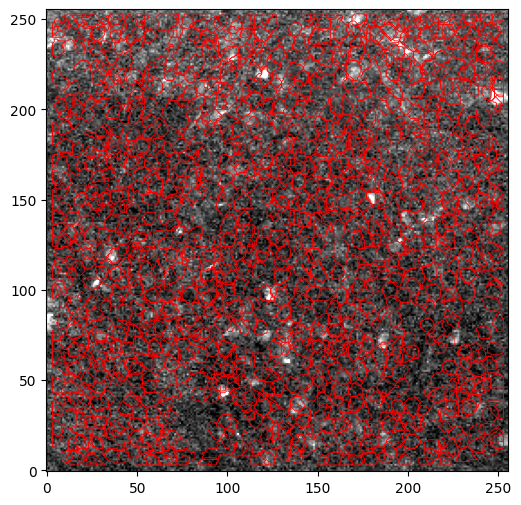

In [4]:
vid = crop_to_mask(network_input, gt_rois)          # remove padding
paths_aligned = masks_to_paths_aligned(gt_rois)

fig, ax = plt.subplots(1,1,figsize=(6,6))
vmin, vmax = np.percentile(vid, [1,99])
im = ax.imshow(vid[0], cmap='gray', origin='lower', vmin=vmin, vmax=vmax)
ax.add_collection(PathCollection(paths_aligned, facecolors='none', edgecolors='red', linewidths=0.6))
H, W = vid.shape[1], vid.shape[2]
ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
plt.show()

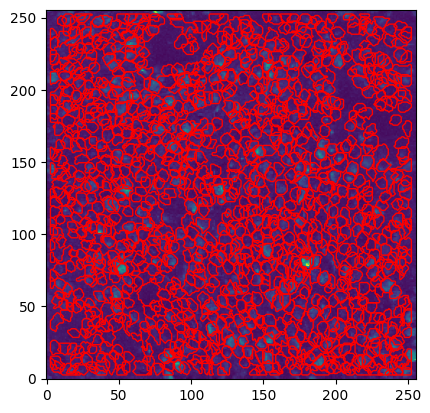

In [5]:
from itertools import chain
ctrs = list(chain.from_iterable(map(find_contours, gt_rois)))
ctrs = [c[:, ::-1] for c in ctrs]
paths = [Path(ctr) for ctr in ctrs]
fig, ax = plt.subplots()
ax.imshow(network_input.max(axis=0), origin="lower")
ax.add_collection(PathCollection(paths, fc="none", ec="r", lw=1))


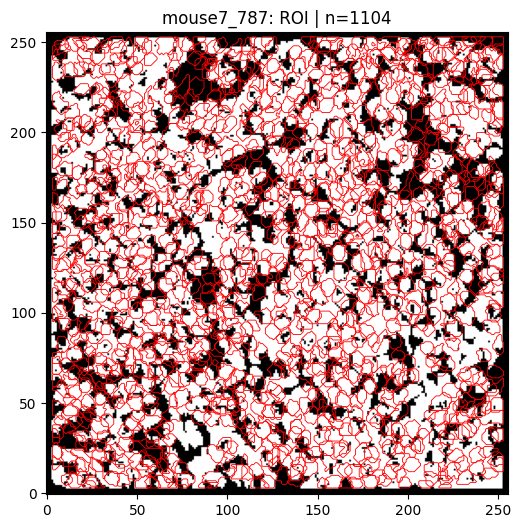

In [6]:
# Black/white GT composite with ROI contours overlay
roi_fill = gt_rois.any(axis=0)  # boolean (H,W) of any ROI pixel

fig, ax = plt.subplots(1,1,figsize=(6,6))
ax.imshow(roi_fill, cmap='gray', origin='lower', vmin=0, vmax=1)
ax.add_collection(PathCollection(paths_aligned, facecolors='none', edgecolors='red', linewidths=0.6))
H, W = roi_fill.shape
ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f"{exp_id}: ROI | n={gt_rois.shape[0]}")
plt.show()


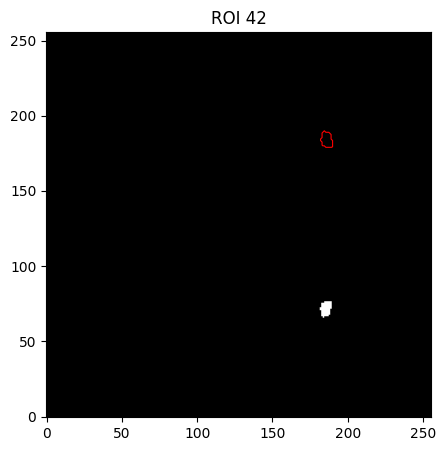

In [7]:
# Rebuild aligned paths after orientation fix
paths_aligned = masks_to_paths_aligned(gt_rois)

# Quick spot-check for a single ROI
i = 42
m = gt_rois[i]
p = masks_to_paths_aligned(gt_rois[i:i+1])
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.imshow(m, cmap='gray', origin='lower', vmin=0, vmax=1)
ax.add_collection(PathCollection(p, facecolors='none', edgecolors='red', linewidths=0.8))
H, W = m.shape
ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f'ROI {i}'); plt.show()

In [8]:
# from skimage.measure import find_contours
# from matplotlib.path import Path
# from matplotlib.collections import PathCollection
# from matplotlib.animation import FuncAnimation
# from IPython.display import HTML, display

# def masks_to_paths_aligned(mask_stack):
#     # mask_stack: (n, H, W); returns list[Path] aligned to origin='lower'
#     H, W = mask_stack.shape[1], mask_stack.shape[2]
#     paths = []
#     for m in mask_stack:
#         for ctr in find_contours(m.astype(float), 0.5):  # (row, col)
#             x = ctr[:, 1]
#             y = H - 1 - ctr[:, 0]  # flip Y for origin='lower'
#             paths.append(Path(np.c_[x, y]))
#     return paths

# def crop_frames_to_mask(frames_img, mask_stack):
#     # Crop padded frames to mask size (padding is on bottom/right in our pipeline)
#     Hm, Wm = mask_stack.shape[1], mask_stack.shape[2]
#     return frames_img[:, :Hm, :Wm]

# def show_overlay_video(frames_img, paths, title, stride=1, color='red', lw=0.6):
#     # frames_img: (T,H,W) already cropped to mask dims
#     vmin, vmax = np.percentile(frames_img, [1, 99])
#     frames = range(0, frames_img.shape[0], stride)

#     fig, ax = plt.subplots(1, 1, figsize=(6, 6))
#     im = ax.imshow(frames_img[0], cmap='gray', vmin=vmin, vmax=vmax, origin='lower')
#     overlay = PathCollection(paths, facecolors='none', edgecolors=color, linewidths=lw)
#     ax.add_collection(overlay)
#     H, W = frames_img.shape[1], frames_img.shape[2]
#     ax.set_xlim(-0.5, W - 0.5)
#     ax.set_ylim(-0.5, H - 0.5)
#     ax.set_aspect('equal')
#     ax.set_title(f'{title} t=0')

#     def update(i):
#         t = frames[i]
#         im.set_data(frames_img[t])
#         ax.set_title(f'{title} t={t}')
#         return [im]

#     anim = FuncAnimation(fig, update, frames=len(frames), interval=40, blit=False)
#     plt.close(fig)
#     return HTML(anim.to_jshtml())

In [9]:
# # 1) Crop video to GT height/width if padded
# video_cropped = crop_frames_to_mask(network_input, gt_rois)

# # 2) Rebuild aligned Paths from GT masks
# gt_paths_aligned = masks_to_paths_aligned(gt_rois)

# # 3) Visualize; contours should now coincide
# display(show_overlay_video(video_cropped, gt_paths_aligned, f'{exp_id} GT contours overlay', stride=1, color='red'))

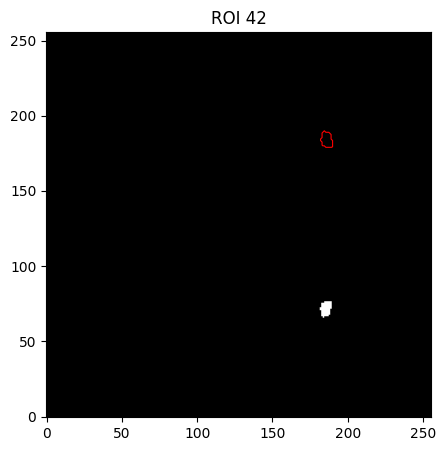

In [10]:
# Recompute paths and re-check alignment after flip
paths_aligned = masks_to_paths_aligned(gt_rois)

idx = 42
m = gt_rois[idx]
p = masks_to_paths_aligned(gt_rois[idx:idx+1])
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.imshow(m, cmap='gray', origin='lower', vmin=0, vmax=1)
ax.add_collection(PathCollection(p, facecolors='none', edgecolors='red', linewidths=0.8))
H, W = m.shape
ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f'ROI {idx}'); plt.show()


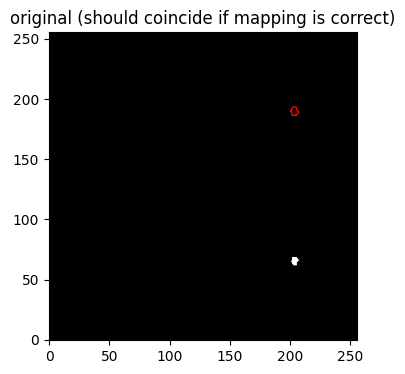

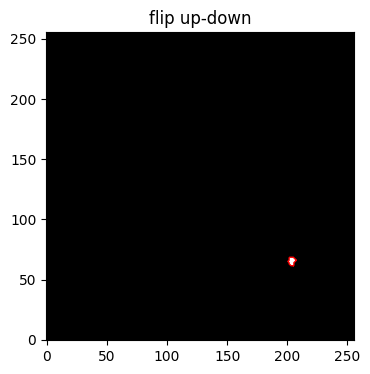

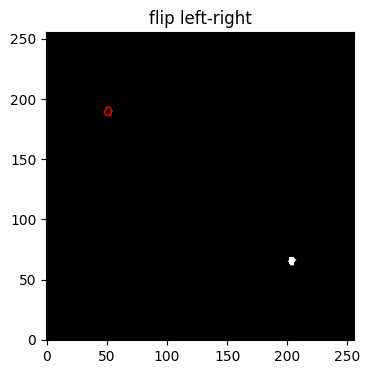

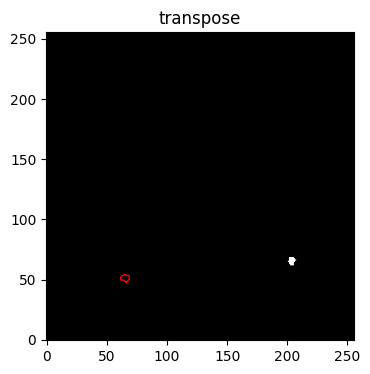

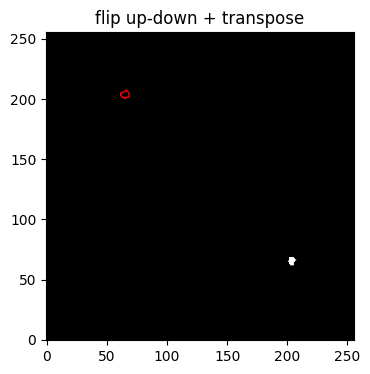

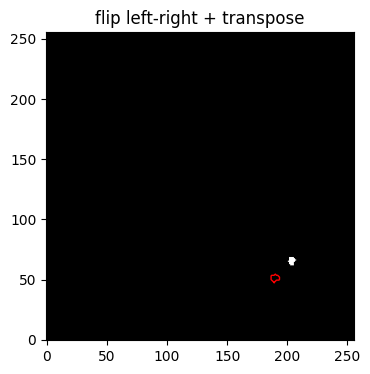

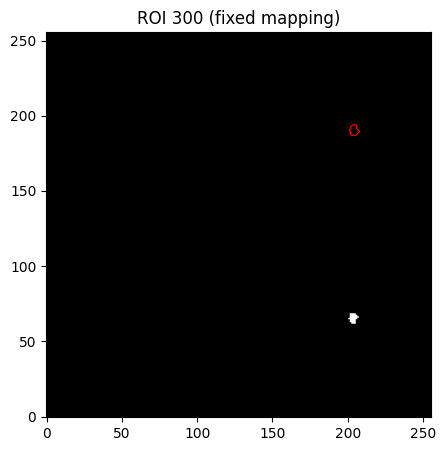

In [13]:
# Verification helper (based on your snippet) + fixed contour builder
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure

def show_alignment(frame, mask, title, origin='lower'):
    H, W = frame.shape
    plt.figure(figsize=(4,4))
    plt.imshow(frame, cmap='gray', origin=origin, vmin=0, vmax=1)
    contours = measure.find_contours(mask.astype(float), 0.5)
    for c in contours:
        if origin == 'lower':
            x, y = c[:, 1], (H - 1 - c[:, 0])
        else:
            x, y = c[:, 1], c[:, 0]
        plt.plot(x, y, 'r', lw=1)
    plt.title(title)
    plt.xlim(-0.5, W-0.5); plt.ylim(-0.5, H-0.5); plt.gca().set_aspect('equal')
    plt.show()

# Try flip/transpose variants on the mask to diagnose orientation
idx = 300
base = gt_rois[idx]
show_alignment(base, base, "original (should coincide if mapping is correct)")
show_alignment(base, np.flipud(base), "flip up-down")
show_alignment(base, np.fliplr(base), "flip left-right")
show_alignment(base, base.T, "transpose")
show_alignment(base, np.flipud(base.T), "flip up-down + transpose")
show_alignment(base, np.fliplr(base.T), "flip left-right + transpose")

# Fixed mapping API for downstream use
from matplotlib.path import Path
from matplotlib.collections import PathCollection
from skimage.measure import find_contours

def masks_to_paths_aligned_lower_origin(masks):
    H, W = masks.shape[1], masks.shape[2]
    paths = []
    for m in masks:
        for ctr in find_contours(m.astype(float), 0.5):
            x = ctr[:, 1] + 0.5
            y = (H - 1 - ctr[:, 0]) + 0.5
            paths.append(Path(np.c_[x, y]))
    return paths

# Quick single-ROI confirmation with the fixed mapping
i = idx
p = masks_to_paths_aligned_lower_origin(gt_rois[i:i+1])
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.imshow(gt_rois[i], cmap='gray', origin='lower', vmin=0, vmax=1)
ax.add_collection(PathCollection(p, facecolors='none', edgecolors='red', linewidths=0.8))
H, W = base.shape
ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f'ROI {i} (fixed mapping)'); plt.show()


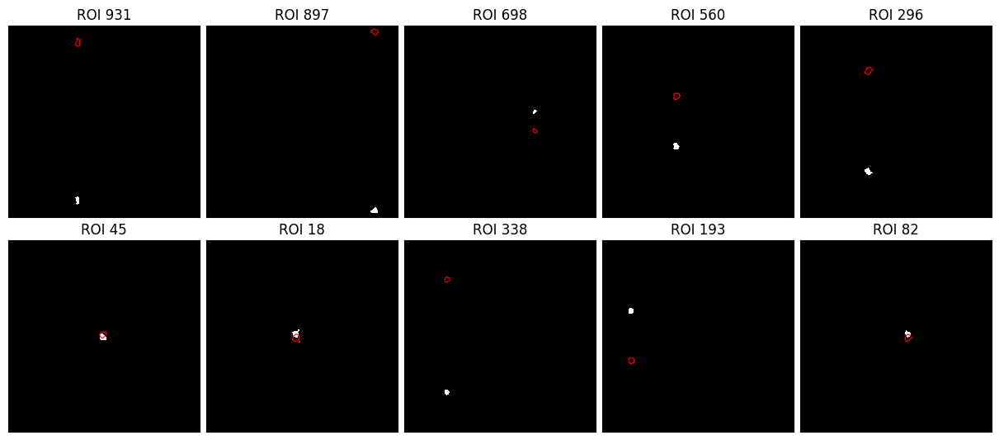

Indices shown: [931 897 698 560 296  45  18 338 193  82]


In [15]:
# Show 10 GT masks with flipUD contours overlaid
num = min(10, gt_rois.shape[0])
rng = np.random.default_rng(0)
indices = rng.choice(gt_rois.shape[0], size=num, replace=False)  # pick 10

fig, axes = plt.subplots(2, 5, figsize=(12, 5.2), constrained_layout=True)
axes = axes.ravel()
for ax, i in zip(axes, indices):
    m = gt_rois[i]
    p = masks_to_paths_aligned_lower_origin(gt_rois[i:i+1])  # flip up-down mapping
    H, W = m.shape
    ax.imshow(
        m, cmap='gray', origin='lower', vmin=0, vmax=1, interpolation='nearest',
        extent=(-0.5, W-0.5, -0.5, H-0.5)
    )
    from matplotlib.collections import PathCollection
    ax.add_collection(PathCollection(p, facecolors='none', edgecolors='red', linewidths=0.8))
    ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
    ax.set_title(f'ROI {i}')
    ax.set_xticks([]); ax.set_yticks([])

# Hide any unused panels if fewer than 10 masks
for ax in axes[num:]:
    ax.axis('off')

plt.show()
print('Indices shown:', indices)

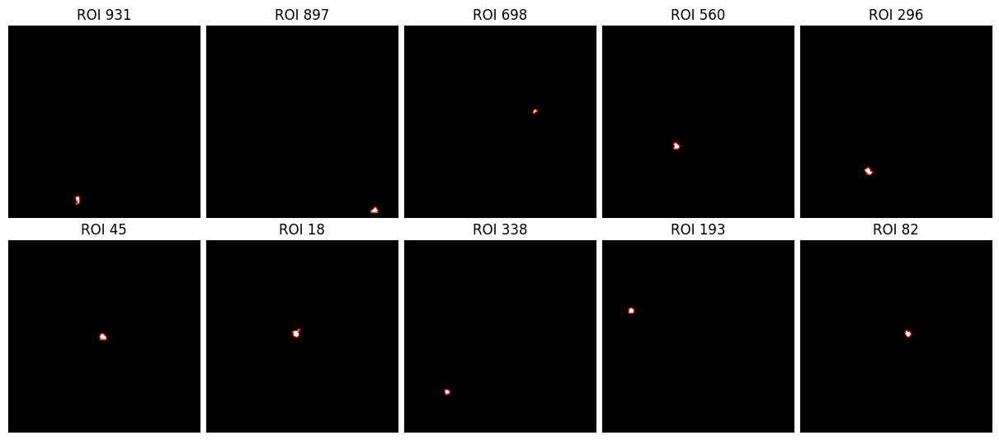

In [18]:
import numpy as np
import matplotlib.pyplot as plt

# pick 10 masks (random or set your own indices list)
num = min(10, gt_rois.shape[0])
rng = np.random.default_rng(0)
indices = rng.choice(gt_rois.shape[0], size=num, replace=False)

fig, axes = plt.subplots(2, 5, figsize=(12, 5.2), constrained_layout=True)
axes = axes.ravel()
for ax, i in zip(axes, indices):
    m = gt_rois[i]
    H, W = m.shape
    ax.imshow(m, cmap='gray', origin='lower', vmin=0, vmax=1, interpolation='nearest')
    ax.contour(m.astype(float), levels=[0.5], colors='r', linewidths=0.8, origin='lower')
    ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
    ax.set_title(f'ROI {i}'); ax.set_xticks([]); ax.set_yticks([])

for ax in axes[num:]:
    ax.axis('off')

plt.show()

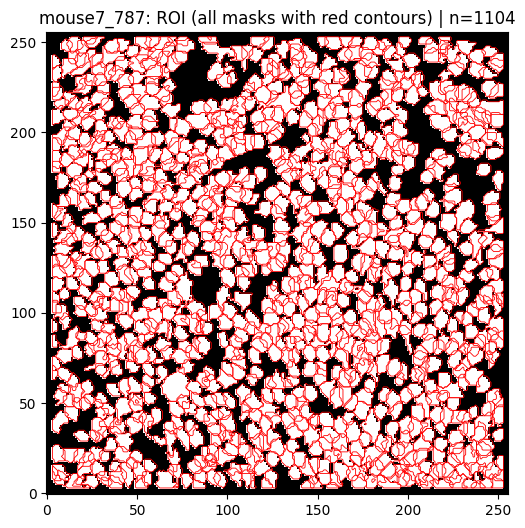

In [25]:
# Composite GT mask image
roi_fill = gt_rois.any(axis=0)
H, W = roi_fill.shape

fig, ax = plt.subplots(1,1,figsize=(6,6))
ax.imshow(
    roi_fill, cmap='gray', origin='lower', vmin=0, vmax=1,
    interpolation='nearest', extent=(-0.5, W-0.5, -0.5, H-0.5)
)

# Draw contours for ALL masks (flipUD handled by origin='lower')
for m in gt_rois:
    ax.contour(m.astype(float), levels=[0.5], colors='r', linewidths=0.6, origin='lower')

ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f"{exp_id}: ROI (all masks with red contours) | n={gt_rois.shape[0]}")
plt.show()

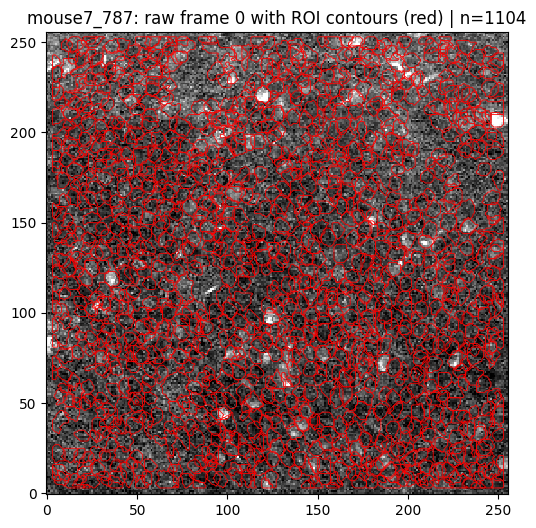

In [30]:
# Raw video frame with ROI contours (red), aligned via origin='lower'
vid = crop_to_mask(network_input, gt_rois)  # ensure same HxW as masks
H, W = vid.shape[1], vid.shape[2]
frame_idx = 0  # change this to view other frames
vmin, vmax = np.percentile(vid, [1, 99])

fig, ax = plt.subplots(1,1,figsize=(6,6))
ax.imshow(
    vid[frame_idx], cmap='gray', origin='lower', vmin=vmin, vmax=vmax,
    interpolation='nearest', extent=(-0.5, W-0.5, -0.5, H-0.5)
)

# Draw contours for ALL masks (flipUD handled by origin='lower')
for m in gt_rois:
    ax.contour(m.astype(float), levels=[0.5], colors='r', linewidths=0.6, origin='lower')

ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f"{exp_id}: raw frame {frame_idx} with ROI contours (red) | n={gt_rois.shape[0]}")
plt.show()


In [31]:
# Video playback with ROI contours (red), aligned to origin='lower'
vid = crop_to_mask(network_input, gt_rois)
paths_aligned = masks_to_paths_aligned(gt_rois)
H, W = vid.shape[1], vid.shape[2]
vmin, vmax = np.percentile(vid, [1, 99])

fig, ax = plt.subplots(1,1,figsize=(6,6))
im = ax.imshow(
    vid[0], cmap='gray', origin='lower', vmin=vmin, vmax=vmax,
    interpolation='nearest', extent=(-0.5, W-0.5, -0.5, H-0.5)
)
overlay = PathCollection(paths_aligned, facecolors='none', edgecolors='red', linewidths=0.6)
ax.add_collection(overlay)
ax.set_xlim(-0.5, W-0.5); ax.set_ylim(-0.5, H-0.5); ax.set_aspect('equal')
ax.set_title(f"{exp_id}: raw video with ROI contours (red) t=0")

# Animate frames while keeping contours static
from matplotlib.animation import FuncAnimation

def update(t):
    im.set_data(vid[t])
    ax.set_title(f"{exp_id}: raw video with ROI contours (red) t={t}")
    return (im,)

anim = FuncAnimation(fig, update, frames=vid.shape[0], interval=40, blit=False)
plt.close(fig)
display(HTML(anim.to_jshtml()))


Animation size has reached 21310337 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
